<a href="https://colab.research.google.com/github/EjbejaranosAI/AI_trends_2023/blob/main/Hands_detection_image_video_mediaPipe.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MediaPipe implementation - Edison Bejarano

https://developers.google.com/mediapipe/solutions/vision/hand_landmarker#models

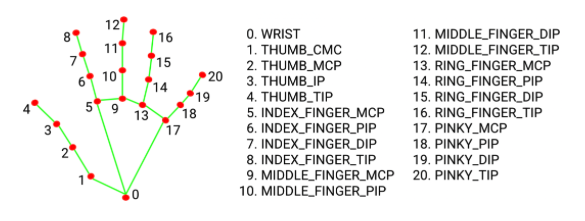

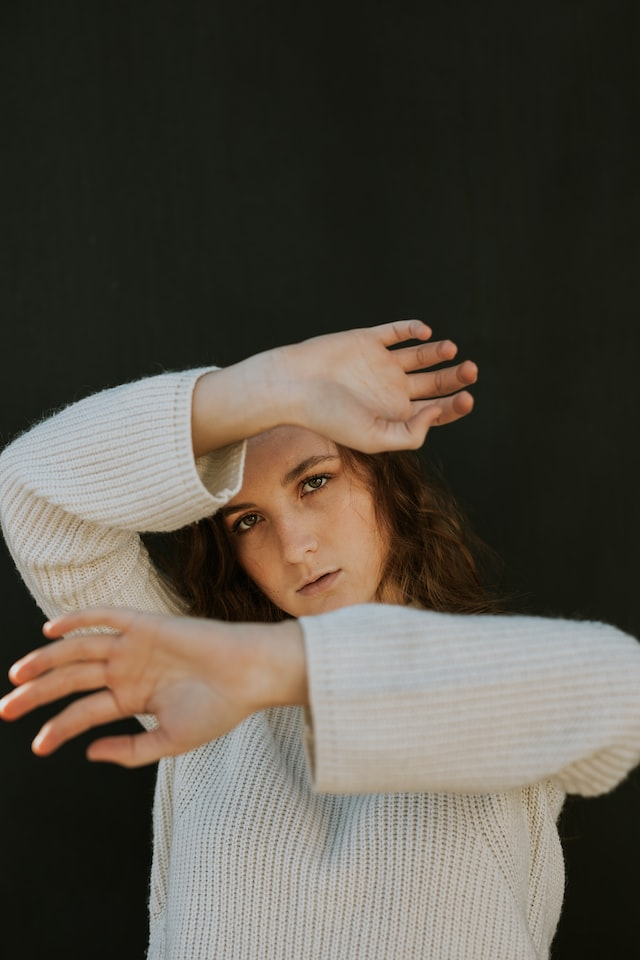

In [ ]:
import sys
colab = 'google.colab' in sys.modules
if colab:
  !pip install -q mediapipe==0.10.0     # Install library
  !wget -q https://storage.googleapis.com/mediapipe-models/hand_landmarker/hand_landmarker/float16/1/hand_landmarker.task # Download task detection model
  !wget -q -O image.jpg https://storage.googleapis.com/mediapipe-tasks/hand_landmarker/woman_hands.jpg  # Download test images



Image detection

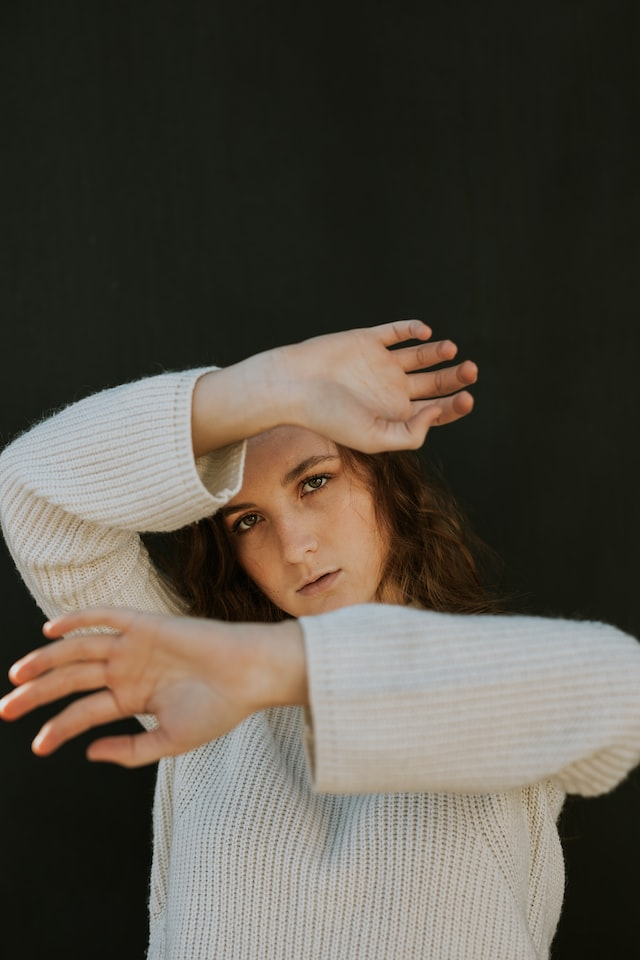

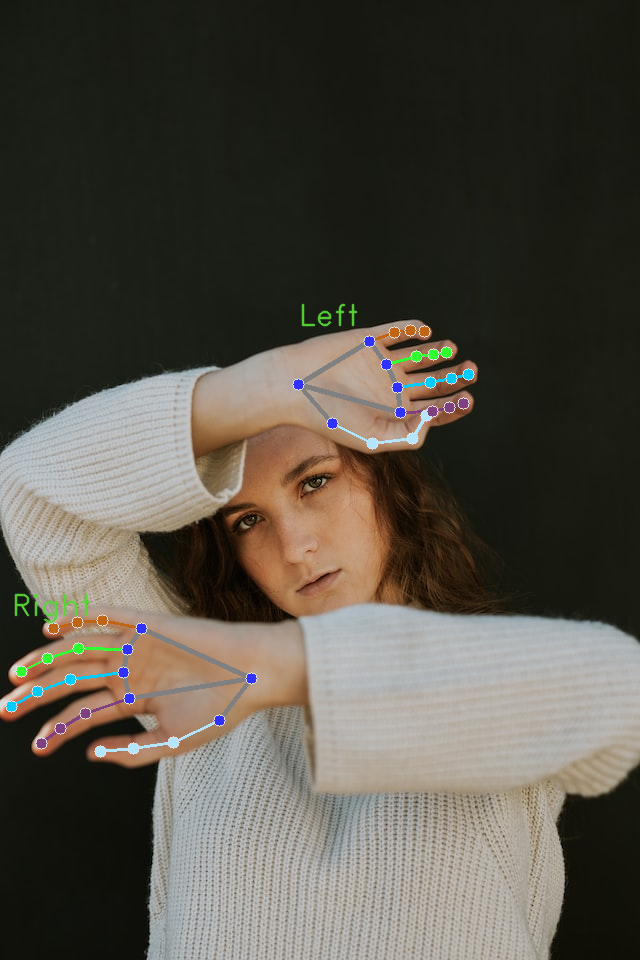

In [ ]:

import os
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

from mediapipe import solutions
from mediapipe.framework.formats import landmark_pb2

img = cv2.imread("image.jpg")
cv2_imshow(img)
MARGIN = 5
FONT_SIZE = 1
FONT_THICKNESS = 1
HANDENESS_TEXT_COLOR = (88, 215, 54)

def draw_landmarks_on_image(rgb_image, detection_result):
  hand_landmarks_list = detection_result.hand_landmarks
  handedness_list = detection_result.handedness
  annotated_image = np.copy(rgb_image)
  for idx in range(len(hand_landmarks_list)):
    hand_landmarks = hand_landmarks_list[idx]
    handedness = handedness_list[idx]

    # Draw the hand landmarks
    hand_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
    hand_landmarks_proto.landmark.extend([
      landmark_pb2.NormalizedLandmark(x=landmark.x, y=landmark.y, z=landmark.z) for landmark in hand_landmarks
    ])

    solutions.drawing_utils.draw_landmarks(
      annotated_image,
      hand_landmarks_proto,
      solutions.hands.HAND_CONNECTIONS,
      solutions.drawing_styles.get_default_hand_landmarks_style(),
      solutions.drawing_styles.get_default_hand_connections_style())

    height, width, _ = annotated_image.shape
    x_coordinates = [landmark.x for landmark in hand_landmarks]
    y_coordinates = [landmark.y for landmark in hand_landmarks]
    text_x = int(min(x_coordinates) * width)
    text_y = int(min(y_coordinates) * height) - MARGIN

    cv2.putText(annotated_image, f"{handedness[0].category_name}", (text_x, text_y), cv2.FONT_HERSHEY_DUPLEX, FONT_SIZE, HANDENESS_TEXT_COLOR, FONT_THICKNESS, cv2.LINE_AA)

  return annotated_image

import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision

base_options = python.BaseOptions(model_asset_path='hand_landmarker.task')
options = vision.HandLandmarkerOptions(base_options=base_options, num_hands=2)
detector = vision.HandLandmarker.create_from_options(options)

image = mp.Image.create_from_file("image.jpg")
detection_result = detector.detect(image)

annotated_image = draw_landmarks_on_image(image.numpy_view(), detection_result)
cv2_imshow(cv2.cvtColor(annotated_image, cv2.COLOR_RGB2BGR))




# Video detection

In [ ]:
# Videos with hands
!wget -q -O Hands_video_1.mp4 #add here your video link
!pip -q install mediapy
!pip install mediapipe

In [ ]:
import cv2
import mediapipe as mp
import mediapy as media
from tqdm import tqdm
import time


def process_video(video_path):
  toc = time.time()
  # Load input video with OpenCV VideoCapture
  cap = cv2.VideoCapture(video_path)

  # Set fps to 5
  #cap.set(cv2.CAP_PROP_FPS, 5)

  # Get frame rate using CV_CAP_PROP_FPS
  fps = cap.get(cv2.CAP_PROP_FPS)
  print(fps)

  # Get the total number of frames
  total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
  print(total_frames)

  # Initialize MediaPipe Hands
  hands = mp.solutions.hands.Hands(
      static_image_mode=False,
      max_num_hands=2,
      min_detection_confidence=0.6,
      min_tracking_confidence=0.6
  )

  processed_frames = []
  left_hand_count = 0
  right_hand_count = 0
  left_hand_time = []
  right_hand_time = []

  # Loop through frames using VideoCapture#read() and tqdm progress bar
  for frame_index in tqdm(range(total_frames), desc="Processing video"):
      ret, frame = cap.read()

      if not ret:
          break

      # Perform hand detection with MediaPipe
      frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
      results = hands.process(frame_rgb)


      if results.multi_hand_landmarks:
        for hand_landmarks in results.multi_hand_landmarks:
            mp.solutions.drawing_utils.draw_landmarks(
                frame, hand_landmarks, mp.solutions.hands.HAND_CONNECTIONS
            )

            # Count left and right hands
            if hand_landmarks.landmark[mp.solutions.hands.HandLandmark.WRIST].x < 0.5:
                left_hand_count += 1
                left_hand_time.append(frame_index / fps)
                hand_name = "Left Hand"
            else:
                right_hand_count += 1
                right_hand_time.append(frame_index / fps)
                hand_name = "Right Hand"

            # Display the hand name on the frame
            cv2.putText(frame, hand_name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2, cv2.LINE_AA)
      # Save the processed frame to the list
      processed_frames.append(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))

  # Release the VideoCapture object
  cap.release()

  # Display the video using mediapy
  media.show_video(processed_frames, fps=fps)

  # Calculate duration in seconds
  duration = total_frames / fps

  # Calculate counts by second
  left_hand_count_per_sec = left_hand_count / fps
  right_hand_count_per_sec = right_hand_count / fps
  tic = time.time()

  print("Left hand total count:", left_hand_count)
  print("Right hand total count:", right_hand_count)
  print("Left hand count per second:", left_hand_count_per_sec)
  print("Right hand count per second:", right_hand_count_per_sec)
  print("Left hand time:", left_hand_time)
  print("Right hand time:", right_hand_time)
  print(f"Time estimated to process the video: {tic-toc}")
  return left_hand_count, right_hand_count, left_hand_count_per_sec, right_hand_count_per_sec, left_hand_time, right_hand_time

video_path = "/content/Hands_video_1.mp4"
left_hand_count, right_hand_count, left_hand_count_per_sec, right_hand_count_per_sec, left_hand_time, right_hand_time = process_video(video_path)

video_path = "/content/Hands_video_2.mp4"
left_hand_count2, right_hand_count2, left_hand_count_per_sec2, right_hand_count_per_sec2, left_hand_time2, right_hand_time2 = process_video(video_path)

video_path = "/content/Hands_video_3.mp4"
left_hand_count3, right_hand_count3, left_hand_count_per_sec3, right_hand_count_per_sec3, left_hand_time3, right_hand_time3 = process_video(video_path)

24.0
1669


Processing video: 100%|██████████| 1669/1669 [01:12<00:00, 22.89it/s]


Left hand total count: 460
Right hand total count: 109
Left hand count per second: 19.166666666666668
Right hand count per second: 4.541666666666667
Left hand time: [12.291666666666666, 12.416666666666666, 12.541666666666666, 12.583333333333334, 12.583333333333334, 12.625, 12.791666666666666, 12.833333333333334, 12.875, 12.916666666666666, 12.958333333333334, 13.0, 13.041666666666666, 13.083333333333334, 13.125, 13.166666666666666, 13.208333333333334, 13.25, 13.291666666666666, 13.333333333333334, 13.375, 13.416666666666666, 13.458333333333334, 13.5, 13.541666666666666, 13.583333333333334, 13.625, 13.666666666666666, 13.708333333333334, 13.75, 13.791666666666666, 13.833333333333334, 13.875, 13.916666666666666, 13.958333333333334, 14.0, 14.041666666666666, 14.083333333333334, 14.125, 14.166666666666666, 14.208333333333334, 14.25, 14.291666666666666, 14.333333333333334, 14.375, 14.416666666666666, 14.458333333333334, 14.5, 14.541666666666666, 14.583333333333334, 14.625, 14.66666666666666

Processing video: 100%|██████████| 858/858 [01:01<00:00, 13.84it/s]


Left hand total count: 27
Right hand total count: 229
Left hand count per second: 1.125
Right hand count per second: 9.541666666666666
Left hand time: [10.125, 10.166666666666666, 10.208333333333334, 10.25, 10.291666666666666, 21.5, 21.541666666666668, 21.541666666666668, 21.708333333333332, 21.791666666666668, 21.833333333333332, 21.875, 21.916666666666668, 21.958333333333332, 22.0, 22.041666666666668, 22.125, 22.166666666666668, 24.416666666666668, 24.458333333333332, 27.791666666666668, 27.875, 27.916666666666668, 32.541666666666664, 32.583333333333336, 32.625, 32.666666666666664]
Right hand time: [0.0, 0.041666666666666664, 0.08333333333333333, 0.125, 0.16666666666666666, 0.20833333333333334, 0.25, 0.2916666666666667, 0.3333333333333333, 0.375, 0.4166666666666667, 0.4583333333333333, 0.5, 0.5416666666666666, 0.5833333333333334, 0.625, 0.6666666666666666, 0.7083333333333334, 0.75, 0.7916666666666666, 0.8333333333333334, 0.875, 0.9166666666666666, 0.9583333333333334, 1.0, 1.041666666

Processing video: 100%|██████████| 2852/2852 [02:25<00:00, 19.55it/s]


Left hand total count: 232
Right hand total count: 1
Left hand count per second: 9.666666666666666
Right hand count per second: 0.041666666666666664
Left hand time: [3.5, 3.5416666666666665, 27.125, 27.208333333333332, 27.25, 27.291666666666668, 27.416666666666668, 27.458333333333332, 27.458333333333332, 27.5, 27.541666666666668, 27.583333333333332, 27.625, 27.666666666666668, 27.708333333333332, 27.75, 27.791666666666668, 27.833333333333332, 27.875, 27.916666666666668, 27.958333333333332, 28.0, 28.708333333333332, 28.75, 28.75, 28.791666666666668, 28.833333333333332, 28.875, 28.916666666666668, 28.958333333333332, 29.0, 29.041666666666668, 29.083333333333332, 29.125, 29.166666666666668, 29.208333333333332, 29.25, 29.291666666666668, 29.333333333333332, 29.375, 29.416666666666668, 29.458333333333332, 29.458333333333332, 29.5, 42.083333333333336, 42.125, 42.166666666666664, 42.208333333333336, 42.25, 42.291666666666664, 42.333333333333336, 42.375, 42.416666666666664, 42.458333333333336,